In [1]:
import xarray
import fsspec
import numpy as np
#import s3fs
import proplot
import os

from matplotlib import pyplot as plt
import pandas

/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: 
The examples.directory rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2. In the future, examples will be found relative to the 'datapath' directory.
  self[key] = other[key]


In [2]:
file_path = '/tube1/cha674/CARS_2022_ancillary_data/MNF/CTD'

base_path_contents =  os.listdir(file_path)
CTD_file_list = []

for i_object in base_path_contents:
    if os.path.isdir(os.path.join(file_path,i_object)):
        dir_contents = os.listdir(os.path.join(file_path,i_object))
        for i_file in dir_contents:
            if os.path.isfile(os.path.join(file_path,i_object,i_file)) and i_file.endswith('.csv'):
                CTD_file_list.append(os.path.join(file_path,i_object,i_file))


#file_names = ['MNF_CTD_2000_2005_cars_domain.csv','MNF_CTD_2006_2012_cars_domain.csv']
#data_dirs = ['2000_2005','2006_2012']

#MNF_CTD_dataframe = pandas.read_csv(os.path.join(file_path,data_dirs[0],file_names[0]))

CTD_file_list.sort()


In [3]:
CTD_file_list

['/tube1/cha674/CARS_2022_ancillary_data/MNF/CTD/2005_2010/NCMI_bbox(90,-50,180,0)_ctd_trawler.csv',
 '/tube1/cha674/CARS_2022_ancillary_data/MNF/CTD/2010_2012/NCMI_bbox(90,-50,180,0)_ctd_trawler_2010.csv',
 '/tube1/cha674/CARS_2022_ancillary_data/MNF/CTD/2012_2014/NCMI_bbox(90,-50,180,0)_ctd_trawler.csv',
 '/tube1/cha674/CARS_2022_ancillary_data/MNF/CTD/2014_2016/NCMI_bbox(90,-50,180,0)_ctd_trawler_2014_2015.csv',
 '/tube1/cha674/CARS_2022_ancillary_data/MNF/CTD/2016_2018/NCMI_bbox(90,-50,180,0)_ctd_trawler_2016_2017.csv',
 '/tube1/cha674/CARS_2022_ancillary_data/MNF/CTD/2018_2020/NCMI_bbox(90,-50,180,0)_ctd_trawler.csv',
 '/tube1/cha674/CARS_2022_ancillary_data/MNF/CTD/2020_2022/NCMI_bbox(90,-50,180,0)_ctd_trawler.csv']

In [4]:
MNF_CTD_dataframe_list = []
for i_CTD_file in CTD_file_list:
    MNF_CTD_dataframe = pandas.read_csv(i_CTD_file)
    MNF_CTD_dataframe_list.append(MNF_CTD_dataframe)

    

/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3257: DtypeWarning: Columns (13) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [5]:
MNF_CTD_dataframe_test = pandas.read_csv(CTD_file_list[5])


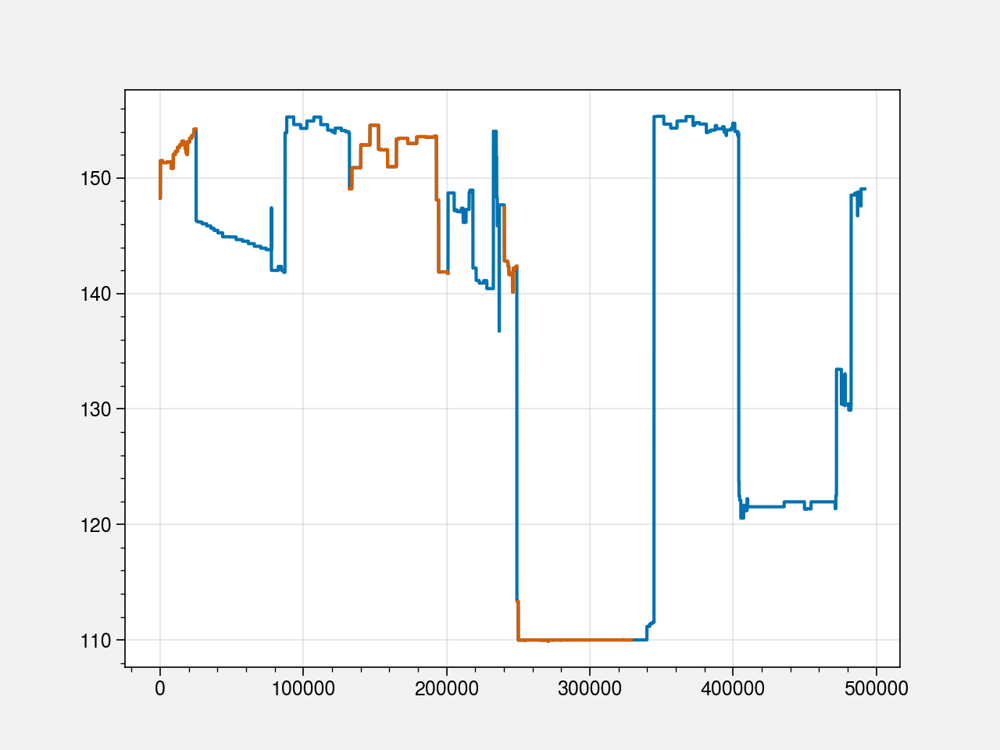

In [6]:
plt.plot(MNF_CTD_dataframe_test['START_LON'].values)
plt.plot(MNF_CTD_dataframe_test['END_LON'].values)
plt.plot(MNF_CTD_dataframe_test['BOTTOM_LON'].values)


In [7]:
Total_MNF_CTD_dataframe = pandas.concat(MNF_CTD_dataframe_list)

In [8]:
Total_MNF_CTD_dataframe.columns

Index(['SURVEY_NAME', 'STATION', 'START_TIME', 'END_TIME', 'MIN_DEPTH',
       'MAX_DEPTH', 'BOTTOM_DEPTH', 'BOTTOM_LAT', 'BOTTOM_LON', 'END_LAT',
       'END_LON', 'START_LAT', 'START_LON', 'PROJECT_NAME', 'MARLIN_ID',
       'MARLIN_UUID', 'PRESSURE', 'ALTITUDE', 'ALTITUDE_QC', 'CDOM', 'CDOM_QC',
       'CONDUCTIVITY', 'CONDUCTIVITY_QC', 'OXYGEN', 'OXYGEN_QC',
       'FLUORESCENCE', 'FLUORESCENCE_QC', 'NITRATE', 'NITRATE_QC', 'OBS',
       'OBS_QC', 'OPTODE', 'OPTODE_QC', 'PH', 'PH_QC', 'PAR', 'PAR_QC',
       'SALINITY', 'SALINITY_QC', 'SIGMA-T', 'SIGMA-T_QC', 'SPAR', 'SPAR_QC',
       'TEMPERATURE', 'TEMPERATURE_QC', 'TRANSMITTANCE', 'TRANSMITTANCE_QC',
       'TURBIDITY', 'TURBIDITY_QC', 'TURBIDITY_SCATTER',
       'TURBIDITY_SCATTER_QC', 'SP_GEO_ANOMALY', 'SP_GEO_ANOMALY_QC',
       'SP_VOL_ANOMALY', 'SP_VOL_ANOMALY_QC'],
      dtype='object')

In [9]:
Total_MNF_CTD_dataframe.loc[pandas.to_datetime(dataframe_for_station['START_TIME']).year==2018]

NameError: name 'dataframe_for_station' is not defined

In [9]:
survey_identifiers = Total_MNF_CTD_dataframe['SURVEY_NAME'].unique()

latitude  = []
longitude = []
time      = []

pressure  = []
temperature = []
salinity   = []
CTD_depth  = []

for i_survey in survey_identifiers:
    
    dataframe_for_survey = Total_MNF_CTD_dataframe.loc[Total_MNF_CTD_dataframe['SURVEY_NAME']==i_survey]
    stations_for_survey  = dataframe_for_survey['STATION'].unique()
    for i_station in stations_for_survey:
        
        dataframe_for_station = dataframe_for_survey.loc[dataframe_for_survey['STATION']==i_station]
        
        
        
        latitude.append(dataframe_for_station['START_LAT'].unique())
        longitude.append(dataframe_for_station['START_LON'].unique())
        CTD_depth.append(dataframe_for_station['BOTTOM_DEPTH'].unique())
        time.append(pandas.to_datetime(dataframe_for_station['START_TIME']).unique())
        
        pressure.append(dataframe_for_station['PRESSURE'].values)
        temperature.append(dataframe_for_station['TEMPERATURE'].values)
        salinity.append(dataframe_for_station['SALINITY'].values)
latitude=np.asarray(latitude).squeeze()
longitude=np.asarray(longitude).squeeze()
CTD_depth = np.asarray(CTD_depth).squeeze()
time = pandas.to_datetime(np.asarray(time).squeeze())

In [62]:
time = pandas.to_datetime(np.asarray(time).squeeze())

In [88]:
#from scipy import interpolate as scipy_interp
#f = scipy_interp.interpolate.interp2d(topo['x'],topo['y'],-topo, kind='cubic')
#
lon_CTD = xarray.DataArray(longitude, dims="z")
lat_CTD = xarray.DataArray(latitude, dims="z")
depth_CTD = topo.interp(x=lon_CTD,y=lat_CTD,method='linear')



/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


(array([1466.,  260.,  108.,  103.,   82.,   92.,   69.,   82.,  244.,
          48.]),
 array([   0.  ,  556.32, 1112.64, 1668.96, 2225.28, 2781.6 , 3337.92,
        3894.24, 4450.56, 5006.88, 5563.2 ]),
 <a list of 10 Patch objects>)

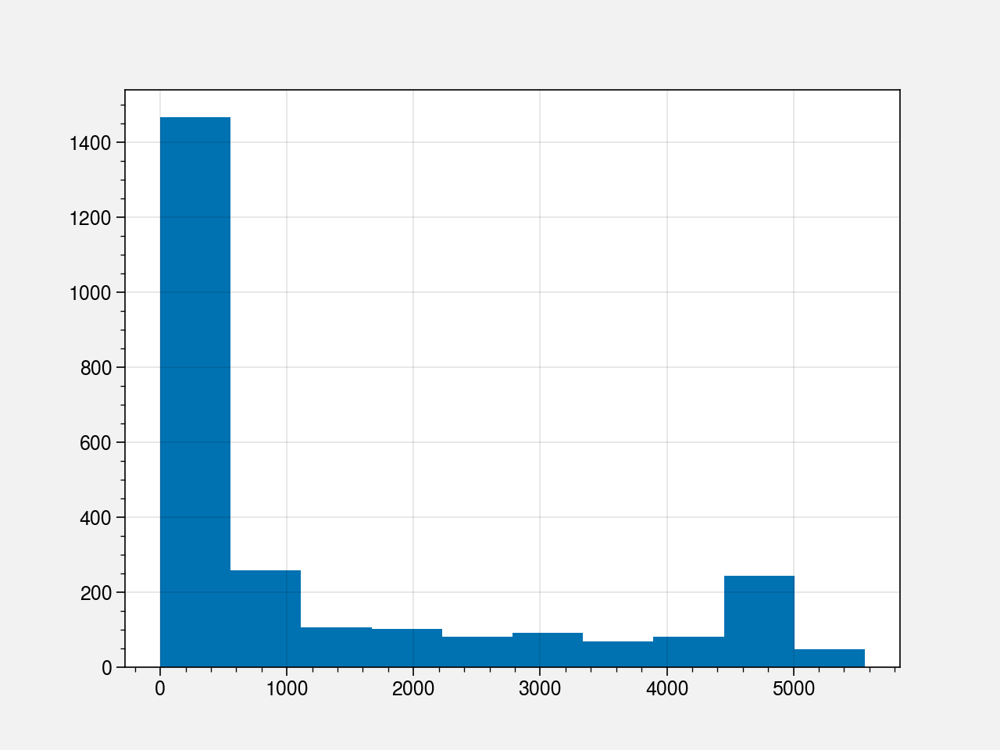

In [94]:
plt.hist(CTD_depth)

MNF_CTD_data_Tas


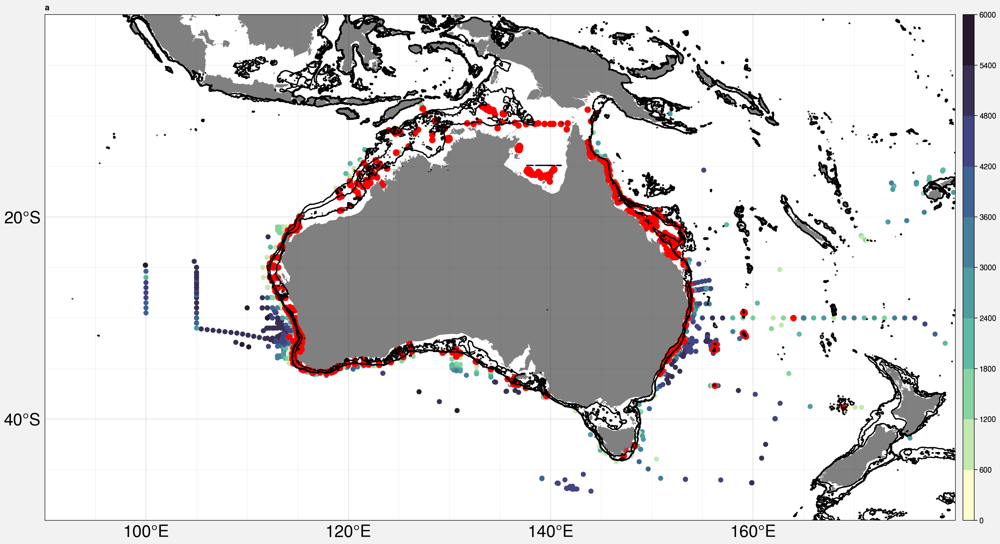

In [102]:

proplot.rc.reso = 'hi'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)

unique_years = time.year.unique()
cycle = proplot.Cycle('Spectral',len(unique_years)) #, 'reds', 'oranges', 15, left=0.1)

#for i_year in unique_years: #unique_years:
#    print(i_year)
fig, axs = proplot.subplots(nrows=1, proj=('cyl'),axwidth=15)
axs.format(
land=True, labels=True, lonlines=20, latlines=20,
gridminor=True,landcolor='grey', abc='a)')
    
cs = axs[0].scatter(longitude,latitude,c=CTD_depth,s=30,label='MNF CTD',cmap='Deep') #,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)
axs[0].scatter(lon_CTD_good_depth,lat_CTD_good_depth,s=50,c='r') #,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)

axs[0].format(lonlim=(90, 180), latlim=(-50, 0), labels=True,gridlabelsize=20)
axs[0].contour(topo['x'],topo['y'],-topo,levels=[50,200,500],colors='black')

    #axs[0].legend(fontsize=20)
#axs[0].legend(loc='lower left',ncols=1,fontsize=25,framealpha=1.0)
#axs[0].annotate('AIMS/MNF for year ' + str(i_year), xy=(0.02, 1.01), xycoords="axes fraction",fontsize=20)
#    figure_path = './Figures'
figure_name = 'MNF_CTD_data_Tas'
fig.colorbar(cs)
print(figure_name)
#fig.savefig(os.path.join(figure_path,figure_name + '.png'), dpi=400)

In [100]:
idx_depth = np.nonzero(CTD_depth<500)[0]
lat_CTD_good_depth = latitude[idx_depth]
lon_CTD_good_depth = longitude[idx_depth]

temperature_CTD_good_depth = [temperature[i] for i in idx_depth]
salinity_CTD_good_depth = [salinity[i] for i in idx_depth]
pressure_CTD_good_depth = [pressure[i] for i in idx_depth]



/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in less
  """Entry point for launching an IPython kernel.


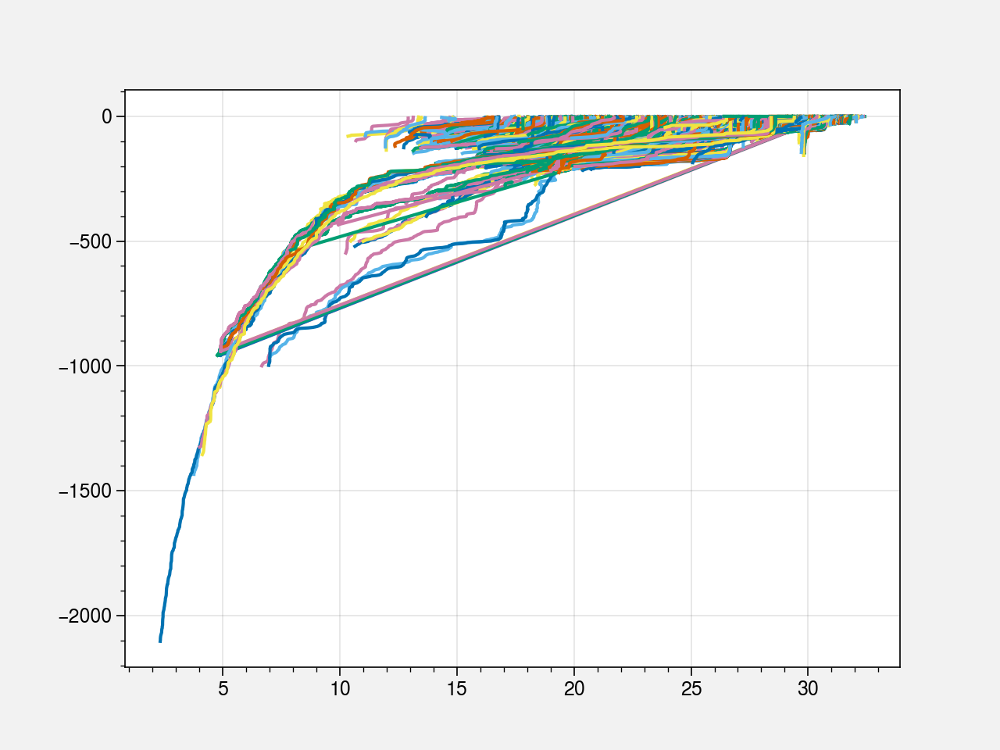

In [92]:
fig = plt.figure(1)
ax = fig.add_subplot(1,1,1)
for i_cast in range(0,len(temperature_CTD_good_depth)):
    plt.plot(temperature_CTD_good_depth[i_cast],-pressure_CTD_good_depth[i_cast])



In [80]:
len(lat_CTD_good_depth)

1607

In [74]:
len(blah)

1607

In [10]:


MNF_XBT_file = '/tube1/cha674/CARS_2022_ancillary_data/MNF/XBT/NCMI_bbox(90,-50,180,0)_xbt_trawler.csv'
MNF_XBT_dataframe = pandas.read_csv(MNF_XBT_file)


In [11]:
survey_identifiers = MNF_XBT_dataframe['Survey'].unique()
XBT_latitude  = []
XBT_longitude = []
XBT_time      = []

#MNF_XBT_dataframe

for i_survey in survey_identifiers:
    
    dataframe_for_survey = MNF_XBT_dataframe.loc[MNF_XBT_dataframe['Survey']==i_survey]
    stations_for_survey  = dataframe_for_survey['Station'].unique()
    for i_station in stations_for_survey:
        
        dataframe_for_station = dataframe_for_survey.loc[dataframe_for_survey['Station']==i_station]
        
        XBT_latitude.append(dataframe_for_station['Start lat'].unique())
        XBT_longitude.append(dataframe_for_station[' Start Lon'].unique())
        XBT_time.append(pandas.to_datetime(dataframe_for_station['Start (UTC)']).unique())
        
XBT_time = pandas.DatetimeIndex(np.asarray(XBT_time).squeeze())
XBT_longitude = np.asarray(XBT_longitude).squeeze()
XBT_latitude  = np.asarray(XBT_latitude).squeeze()    

In [172]:
MNF_XBT_dataframe.columns

Index(['Survey', 'Station', 'Start (UTC)', ' Depth min (m) ', 'Depth max (m)',
       'Start lat', ' Start Lon', 'Project', 'MARLIN UUID', 'Depth',
       'Temperature', 'Temperature QC', 'Salinity', 'Salinity QC'],
      dtype='object')

In [50]:


da_lon = xarray.DataArray(longitude,dims=['time'],coords={'time':time})
da_lat = xarray.DataArray(latitude,dims=['time'],coords={'time':time})


In [51]:
da_lat_2018 = da_lat.sel(time=slice('2018-01-01','2018-12-31'))
da_lon_2018 = da_lon.sel(time=slice('2018-01-01','2018-12-31'))

/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/xarray/core/dataset.py:2183: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  self, indexers=indexers, method=method, tolerance=tolerance


KeyError: "cannot represent labeled-based slice indexer for dimension 'time' with a slice over integer positions; the index is unsorted or non-unique"

In [85]:
#latitude  = []
#longitude = []
#time      = []

for i_survey in survey_identifiers:
    
    dataframe_for_survey = MNF_CTD_dataframe.loc[MNF_CTD_dataframe['SURVEY_NAME']==i_survey]
    stations_for_survey  = dataframe_for_survey['STATION'].unique()
    for i_station in stations_for_survey:
        
        dataframe_for_station = dataframe_for_survey.loc[dataframe_for_survey['STATION']==i_station]
        pressure = dataframe_for_station['PRESSURE']
        temperature = dataframe_for_station['TEMPERATURE']
        
        #print(temperature.size)
        #print(pressure.size)
        #plt.plot(temperature,-pressure)
        
        

In [12]:
AIMS_data_path ='/tube1/cha674/CARS_2022_ancillary_data/AIMS/CTD/CTD'
dir_contents = os.listdir(AIMS_data_path)

AIMS_CTD_file_list = []
for i_file in dir_contents:
    if os.path.isfile(os.path.join(AIMS_data_path,i_file)) and i_file.endswith('.csv'):
        AIMS_CTD_file_list.append(os.path.join(AIMS_data_path,i_file))



In [13]:
import csv

AIMS_latitude  = []
AIMS_longitude = []
AIMS_date      = []

for i_file in AIMS_CTD_file_list:
    
    with open(i_file) as csv_file:
        csv_reader = csv.reader(csv_file, delimiter=',')
        line_count = 0
        found_date = False
        for row in csv_reader:
            #print(row)
            if row.count('LATITUDE:')>0:
                AIMS_latitude.append(float(row[1]))
            elif row.count('LONGITUDE:')>0:
                AIMS_longitude.append(float(row[1]))
            
            
            elif row.count('SAMPLE DATE:')>0: #row.count('SAMPLE DATE:')>0:
                found_date = True
                AIMS_date.append(pandas.to_datetime(row[1]))
            line_count = line_count + 1
            if line_count > 20 and not found_date:
                AIMS_longitude.pop()
                AIMS_latitude.pop()
                break
                
            

AttributeError: 'list' object has no attribute 'shape'

In [137]:
AIMS_longitude.shape

(2396,)

In [14]:
AIMS_latitude=np.asarray(AIMS_latitude)
AIMS_longitude=np.asarray(AIMS_longitude)
AIMS_date = pandas.to_datetime(np.asarray(AIMS_date))

AIMS_CTD_dataframe = pandas.DataFrame({'time': AIMS_date, 'longitude': AIMS_longitude,'latitude': AIMS_latitude})
AIMS_CTD_dataframe = AIMS_CTD_dataframe.set_index('time')


In [15]:
AIMS_dataframe = pandas.read_csv(AIMS_CTD_file_list[18],header=16,skip_blank_lines=False)

AIMS_MNF_XBT_CTD_data_scatter_all_years


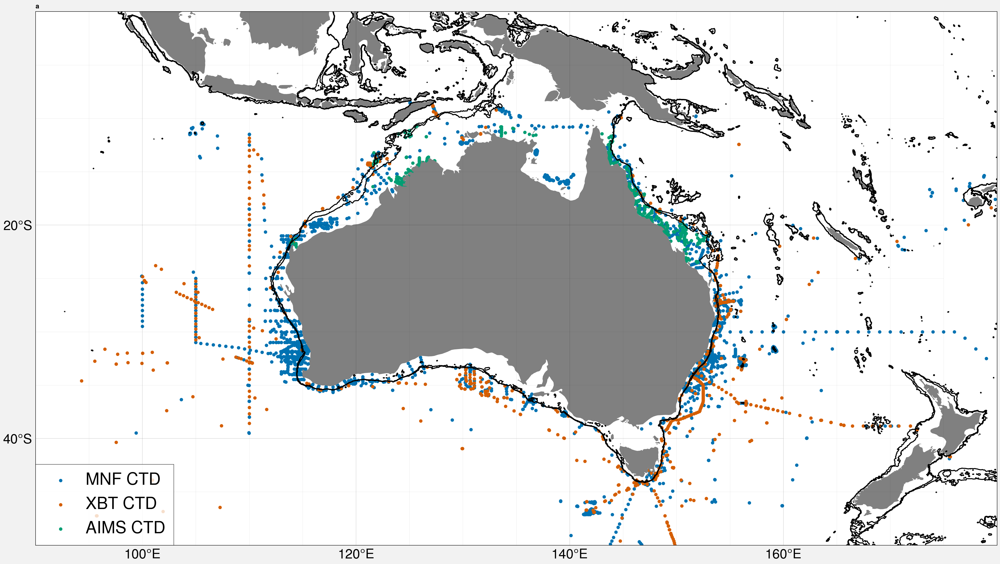

In [27]:

proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)

#unique_years = time.year.unique()
#cycle = proplot.Cycle('Spectral',len(unique_years)) #, 'reds', 'oranges', 15, left=0.1)

#for i_year in unique_years: #unique_years:
#print(i_year)
fig, axs = proplot.subplots(nrows=1, proj=('cyl'),axwidth=20)
axs.format(
land=True, labels=True, lonlines=20, latlines=20,
gridminor=True,landcolor='grey', abc='a)'    )
    
axs[0].scatter(longitude,latitude,s=20,label='MNF CTD') #,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)
axs[0].scatter(XBT_longitude,XBT_latitude,s=20,label='XBT CTD') #,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)

    
    
axs[0].scatter(AIMS_longitude,AIMS_latitude,s=20,label='AIMS CTD') #,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)

axs[0].format(lonlim=(90, 180), latlim=(-50, 0), labels=True,gridlabelsize=20)
axs[0].contour(topo['x'],topo['y'],-topo,levels=[200,500],colors='black')

axs[0].legend(loc='lower left',ncols=1,fontsize=25,framealpha=1.0)
#axs[0].annotate('AIMS/MNF for year ' + str(i_year), xy=(0.02, 1.01), xycoords="axes fraction",fontsize=20)
figure_path = './Figures'
figure_name = 'AIMS_MNF_XBT_CTD_data_scatter_all_years'
print(figure_name)
fig.savefig(os.path.join(figure_path,figure_name + '.png'), dpi=400)

In [129]:
AIMS_dataframe

,DEPTH,PARAMETER,VALUE,QAQC_VALUE,QAQC_FLAG
0,1.0,flECO-AFL: Fluorescence WET Labs ECO-AFL/FL [...,0.3994,NaN,NaN
1,1.0,sal00: Salinity Practical [PSU],32.1320,NaN,NaN
2,1.0,sigma-t00: Density [sigma-t kg/m^3 ],19.9906,NaN,NaN
3,1.0,tv268C: Temperature [IPTS-68 deg C],28.7700,NaN,NaN
4,2.0,flECO-AFL: Fluorescence WET Labs ECO-AFL/FL [...,0.4095,NaN,NaN
...,...,...,...,...,...
95,24.0,tv268C: Temperature [IPTS-68 deg C],27.6312,NaN,NaN
96,25.0,flECO-AFL: Fluorescence WET Labs ECO-AFL/FL [...,1.2841,NaN,NaN
97,25.0,sal00: Salinity Practical [PSU],34.8129,NaN,NaN
98,25.0,sigma-t00: Density [sigma-t kg/m^3 ],22.3766,NaN,NaN


In [22]:
LONGITUDE_LIM_EAST = 180
LONGITUDE_LIM_WEST = 90

LATITUDE_LIM_SOUTH = -50
LATITUDE_LIM_NORTH = 0 

topography_file_path = '/tube1/cha674/ETOPO'
topography_file_name = 'ETOPO1_Ice_g_gmt4.grd'

etopo_dataset = xarray.open_dataset(os.path.join(topography_file_path,topography_file_name))
topo = etopo_dataset['z'].sel(x=slice(LONGITUDE_LIM_WEST,LONGITUDE_LIM_EAST),y=slice(LATITUDE_LIM_SOUTH,LATITUDE_LIM_NORTH)).load()

2005
AIMS_MNF_XBT_CTD_data_scatter_for_year_2005
2006
AIMS_MNF_XBT_CTD_data_scatter_for_year_2006
2007
AIMS_MNF_XBT_CTD_data_scatter_for_year_2007
2008
AIMS_MNF_XBT_CTD_data_scatter_for_year_2008
2009
AIMS_MNF_XBT_CTD_data_scatter_for_year_2009
2010
AIMS_MNF_XBT_CTD_data_scatter_for_year_2010
2011
AIMS_MNF_XBT_CTD_data_scatter_for_year_2011
2012
AIMS_MNF_XBT_CTD_data_scatter_for_year_2012
2013
AIMS_MNF_XBT_CTD_data_scatter_for_year_2013
2015
AIMS_MNF_XBT_CTD_data_scatter_for_year_2015
2014
AIMS_MNF_XBT_CTD_data_scatter_for_year_2014
2016
AIMS_MNF_XBT_CTD_data_scatter_for_year_2016
2017
AIMS_MNF_XBT_CTD_data_scatter_for_year_2017
2018
AIMS_MNF_XBT_CTD_data_scatter_for_year_2018
2019
AIMS_MNF_XBT_CTD_data_scatter_for_year_2019
2020
AIMS_MNF_XBT_CTD_data_scatter_for_year_2020
2021
AIMS_MNF_XBT_CTD_data_scatter_for_year_2021


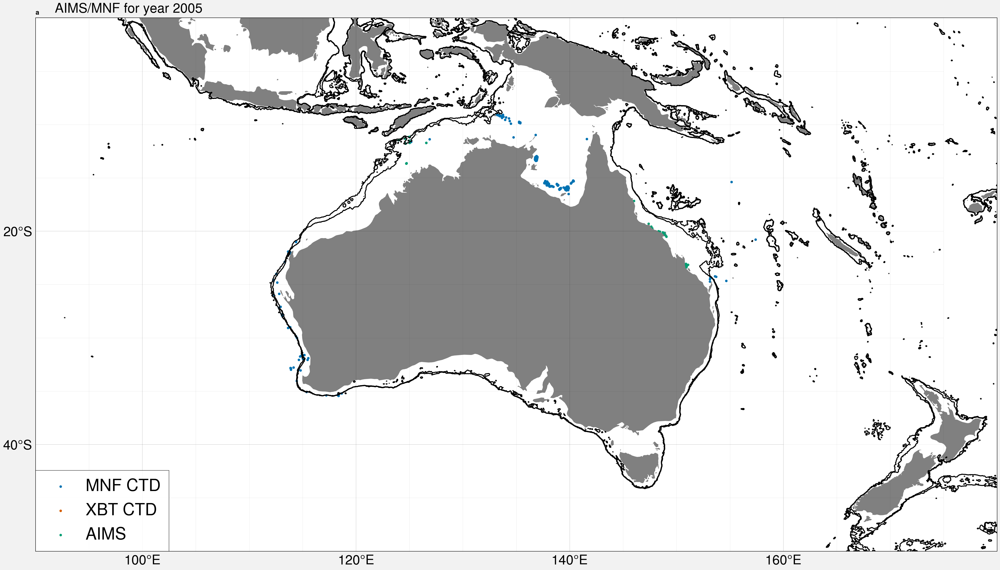

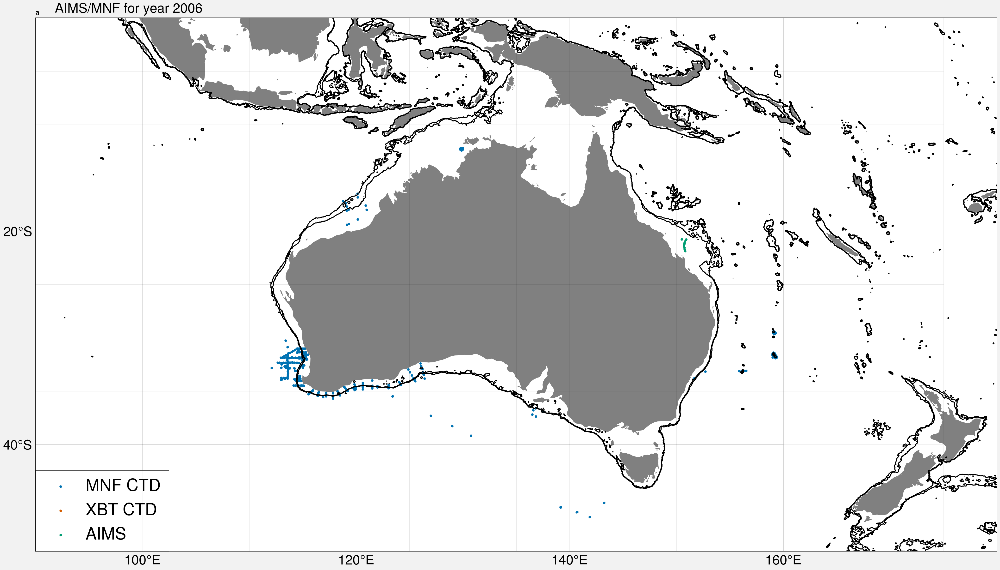

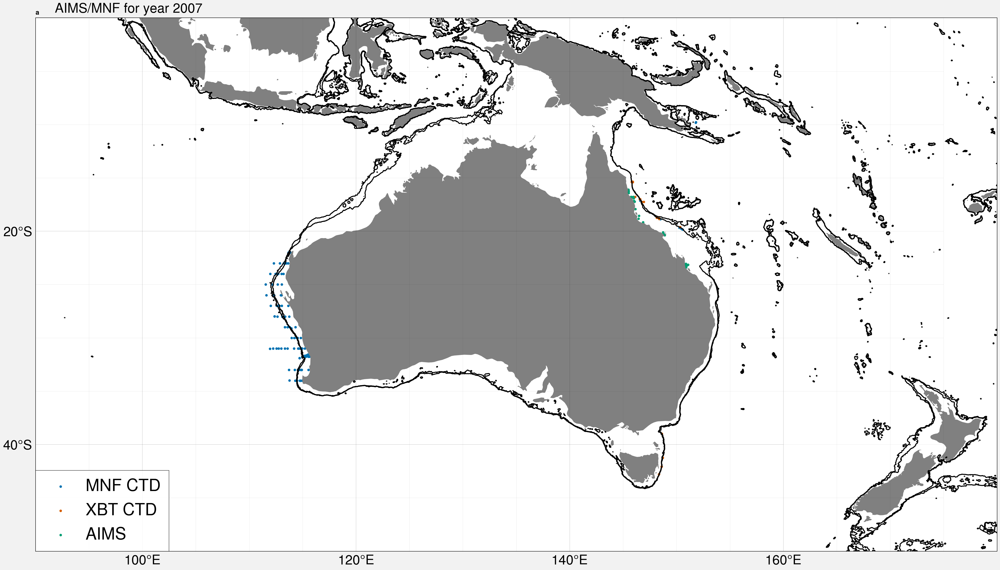

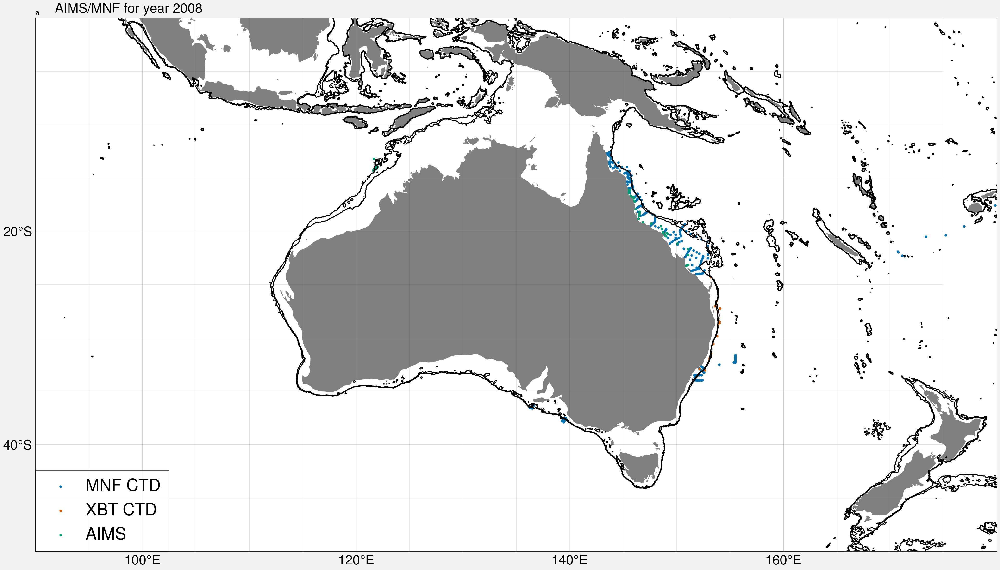

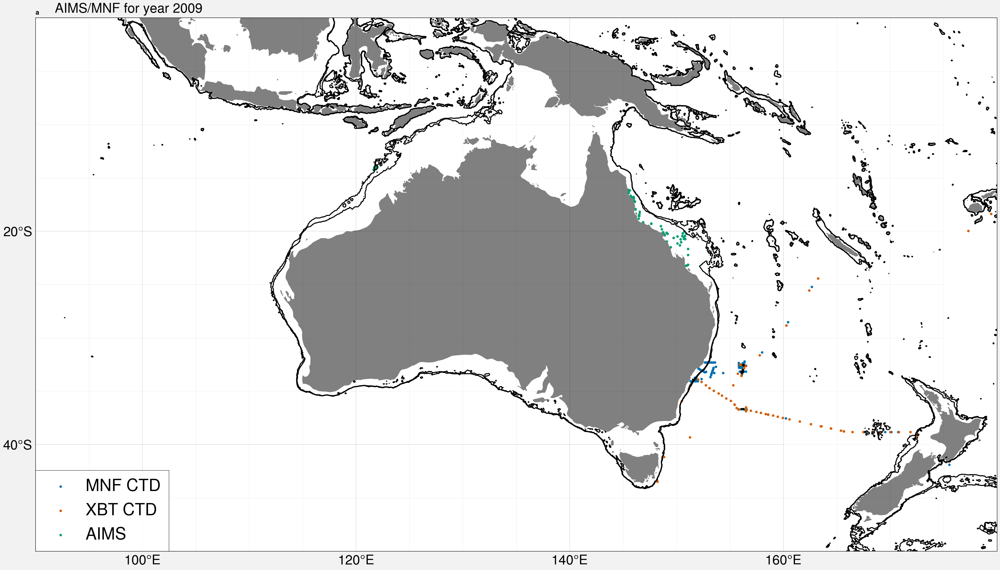

...

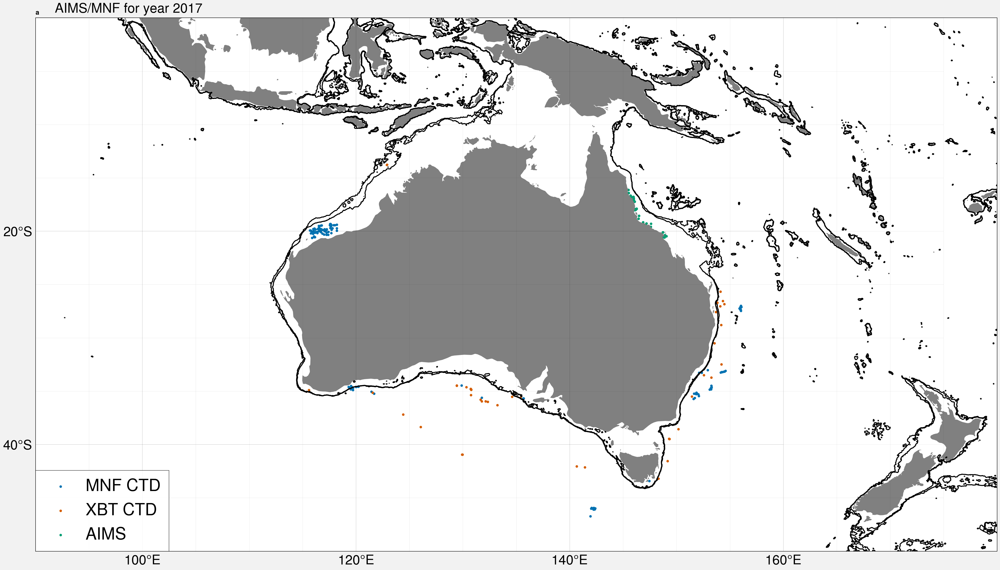

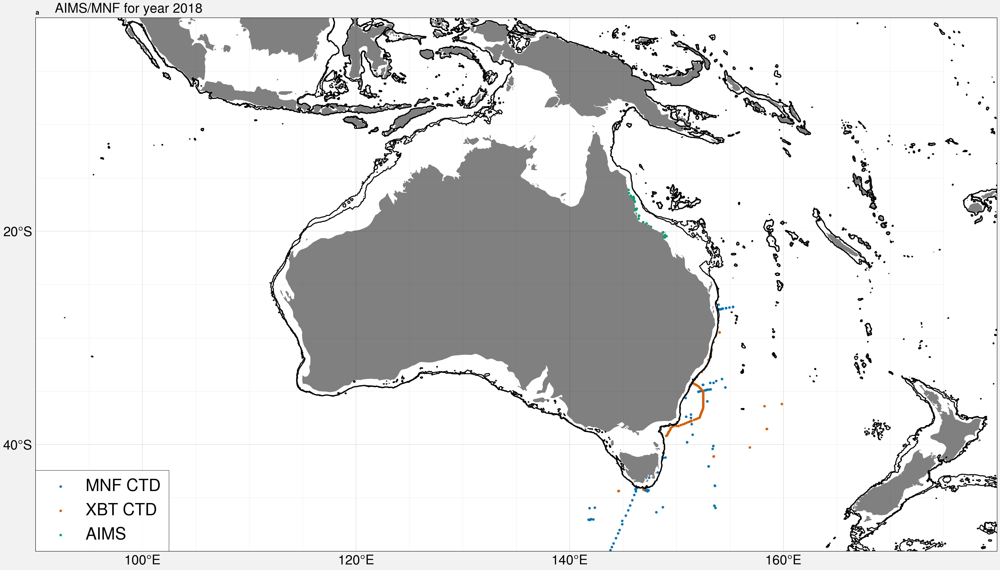

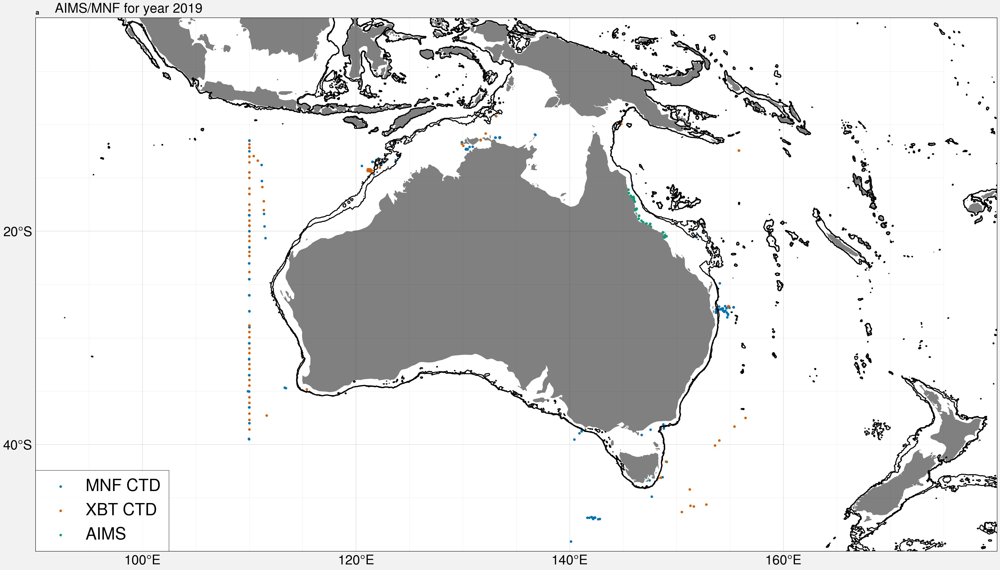

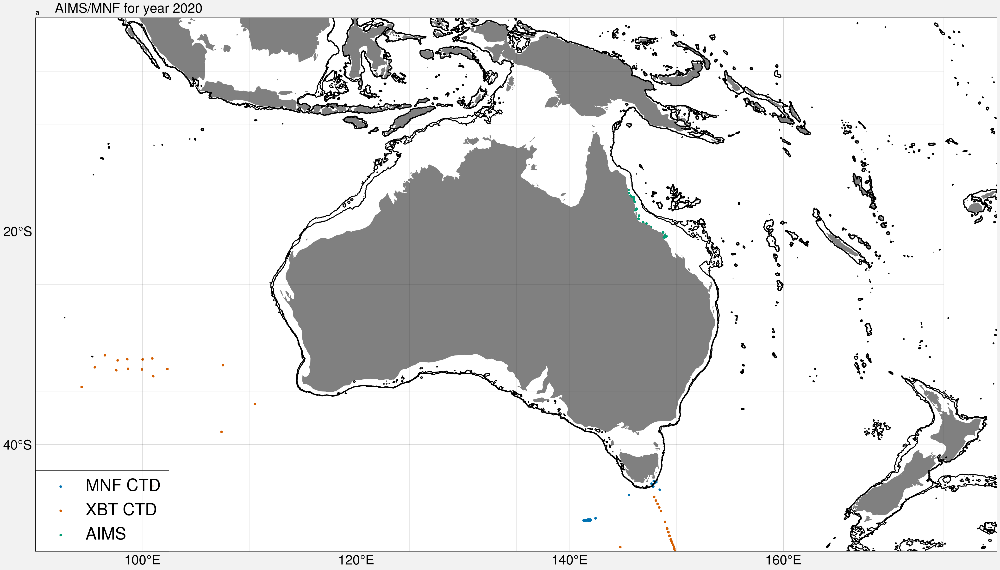

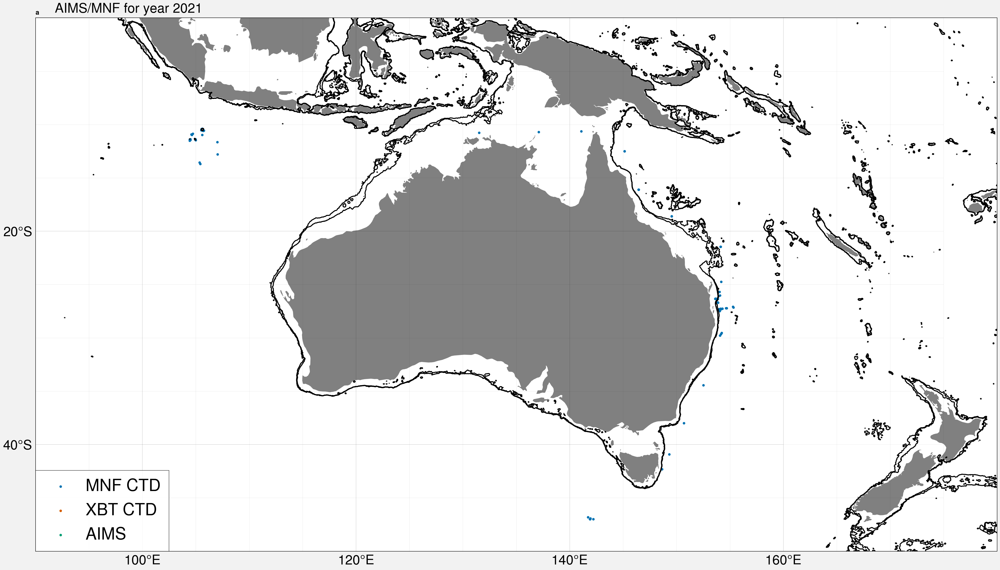

In [183]:

proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)

unique_years = time.year.unique()
cycle = proplot.Cycle('Spectral',len(unique_years)) #, 'reds', 'oranges', 15, left=0.1)

for i_year in unique_years: #unique_years:
    print(i_year)
    fig, axs = proplot.subplots(nrows=1, proj=('cyl'),axwidth=20)
    axs.format(
    land=True, labels=True, lonlines=20, latlines=20,
    gridminor=True,landcolor='grey', abc='a)'
    )
    year_index = np.nonzero(time.year==i_year)[0]
    
    axs[0].scatter(longitude[year_index],latitude[year_index],s=10,label='MNF CTD') #,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)
    XBT_year_index = np.nonzero(XBT_time.year==i_year)[0]
    axs[0].scatter(XBT_longitude[XBT_year_index],XBT_latitude[XBT_year_index],s=10,label='XBT CTD') #,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)

    
    AIMS_year_index = np.nonzero(AIMS_date.year==i_year)[0]
    
    axs[0].scatter(AIMS_longitude[AIMS_year_index],AIMS_latitude[AIMS_year_index],s=10,label='AIMS') #,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)

    axs[0].format(lonlim=(90, 180), latlim=(-50, 0), labels=True,gridlabelsize=20)
    axs[0].contour(topo['x'],topo['y'],-topo,levels=[200,500],colors='black')

    #axs[0].legend(fontsize=20)
    axs[0].legend(loc='lower left',ncols=1,fontsize=25,framealpha=1.0)
    axs[0].annotate('AIMS/MNF for year ' + str(i_year), xy=(0.02, 1.01), xycoords="axes fraction",fontsize=20)
    figure_path = './Figures'
    figure_name = 'AIMS_MNF_XBT_CTD_data_scatter_for_year_' + str(i_year)                                                
    print(figure_name)
    fig.savefig(os.path.join(figure_path,figure_name + '.png'), dpi=400)

In [156]:
AIMS_date.year

Int64Index([2011, 2011, 2004, 2012, 2010, 2005, 2014, 2011, 2009, 2015,
            ...
            2012, 2013, 2019, 2009, 2015, 2016, 2015, 2019, 2015, 2011],
           dtype='int64', length=2389)

In [38]:
unique_years

Int64Index([2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2015, 2014,
            2016, 2017, 2018, 2019, 2020, 2021],
           dtype='int64')

In [30]:
unique_years

Int64Index([], dtype='int64')

In [85]:
latitude[year_index]

array([ -6.33319,  -8.99589,  -8.98351, -10.47241, -10.46959, -10.10577,
        -9.80017,  -9.41086,  -9.79884, -10.0104 , -10.09034, -10.27862,
       -10.4682 , -10.45938, -10.49344, -10.53666, -10.46834, -10.47472,
       -10.50213, -10.49624, -10.2918 , -10.37726,  -9.59981, -10.49144,
       -10.49245, -10.86817, -10.87087, -10.86511, -10.86911, -10.86569,
       -10.87387, -10.91699, -11.2521 , -12.20868, -12.18746, -12.18115,
       -12.19564, -12.20356, -12.24601,       nan,       nan,       nan,
             nan,       nan,       nan,       nan,       nan,       nan,
             nan,       nan,       nan,       nan,       nan,       nan,
             nan,       nan])

In [81]:
year_index.shape

(56,)

In [43]:
dataframe_for_survey.loc[dataframe_for_survey['STATION']==1]

,SURVEY_NAME,STATION,START_TIME,END_TIME,MIN_DEPTH,MAX_DEPTH,BOTTOM_DEPTH,BOTTOM_LAT,BOTTOM_LON,END_LAT,...,FLUORESCENCE,FLUORESCENCE_QC,NITRATE,NITRATE_QC,PH,PH_QC,SALINITY,SALINITY_QC,TEMPERATURE,TEMPERATURE_QC
0,FR200001,1,16-JAN-2000 04:38:00,16-JAN-2000 05:41:00,0.0,1382.0,1376.0,-9.99867,150.51367,-10.0085,...,21.938000,44.0,NaN,NaN,NaN,NaN,33.606998,32.0,30.020000,32.0
1,FR200001,1,16-JAN-2000 04:38:00,16-JAN-2000 05:41:00,0.0,1382.0,1376.0,-9.99867,150.51367,-10.0085,...,29.775999,44.0,NaN,NaN,NaN,NaN,33.792999,32.0,29.874001,32.0
2,FR200001,1,16-JAN-2000 04:38:00,16-JAN-2000 05:41:00,0.0,1382.0,1376.0,-9.99867,150.51367,-10.0085,...,23.263000,44.0,NaN,NaN,NaN,NaN,33.834000,32.0,29.834999,32.0
3,FR200001,1,16-JAN-2000 04:38:00,16-JAN-2000 05:41:00,0.0,1382.0,1376.0,-9.99867,150.51367,-10.0085,...,26.313999,44.0,NaN,NaN,NaN,NaN,33.939999,32.0,29.865999,32.0
4,FR200001,1,16-JAN-2000 04:38:00,16-JAN-2000 05:41:00,0.0,1382.0,1376.0,-9.99867,150.51367,-10.0085,...,32.500999,44.0,NaN,NaN,NaN,NaN,34.132000,32.0,29.826000,32.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
686,FR200001,1,16-JAN-2000 04:38:00,16-JAN-2000 05:41:00,0.0,1382.0,1376.0,-9.99867,150.51367,-10.0085,...,31.358000,44.0,NaN,NaN,NaN,NaN,35.034000,32.0,13.347000,32.0
687,FR200001,1,16-JAN-2000 04:38:00,16-JAN-2000 05:41:00,0.0,1382.0,1376.0,-9.99867,150.51367,-10.0085,...,31.764000,44.0,NaN,NaN,NaN,NaN,35.034000,32.0,13.347000,32.0
688,FR200001,1,16-JAN-2000 04:38:00,16-JAN-2000 05:41:00,0.0,1382.0,1376.0,-9.99867,150.51367,-10.0085,...,31.378000,44.0,NaN,NaN,NaN,NaN,35.034000,32.0,13.348000,32.0
689,FR200001,1,16-JAN-2000 04:38:00,16-JAN-2000 05:41:00,0.0,1382.0,1376.0,-9.99867,150.51367,-10.0085,...,31.330999,44.0,NaN,NaN,NaN,NaN,35.034000,32.0,13.348000,32.0
